In [1]:
import torch
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import pandas as pd
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import numpy as np
from augmentations.aug import get_augmentor



from fasterrcnn.model import get_model
from fasterrcnn.config import config
from fasterrcnn.utils.data import WheatDataset, collate_fn

In [2]:
conf = config()
conf.DEVICE = torch.device('cuda:0')
augmentor = get_augmentor()
WD_Test = WheatDataset(conf, is_train=False, augmentor=augmentor, augmentation=True, normalize=False)

model_path = 'saved_weights/fasterrcnn/GWD_FASTERRCNN_0623V03_EPOCH_16_CHECKPOINT_0_SCORE_0.0000_LOSS_195.5754.pth'
model = get_model(saved_weights=model_path)

In [3]:
model.to(conf.DEVICE)
_ = model.eval()

In [ ]:
len(WD_Test)

C:\ProgramData\Anaconda3\lib\site-packages\torch\nn\functional.py:2854: UserWarning: The default behavior for interpolate/upsample with float scale_factor will change in 1.6.0 to align with other frameworks/libraries, and use scale_factor directly, instead of relying on the computed output size. If you wish to keep the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor will change "
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  # Remove the CWD from sys.path while we load stuff.
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:37: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous a

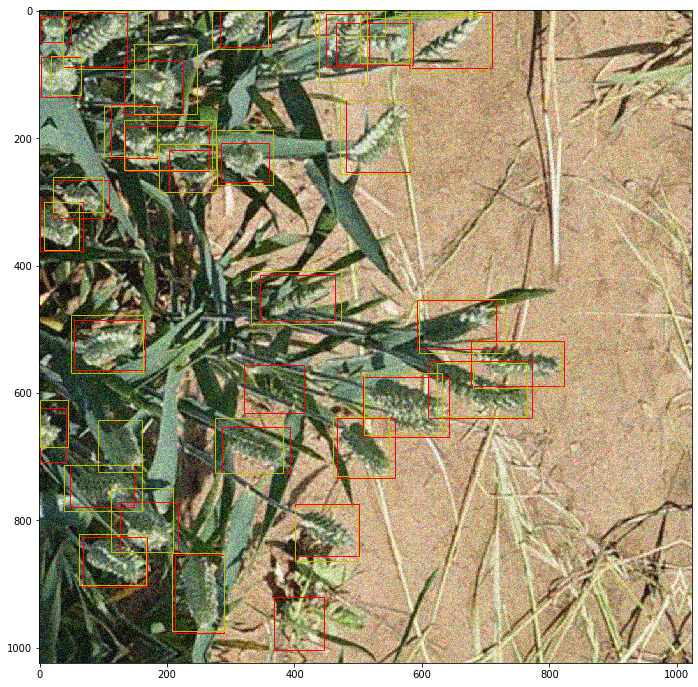

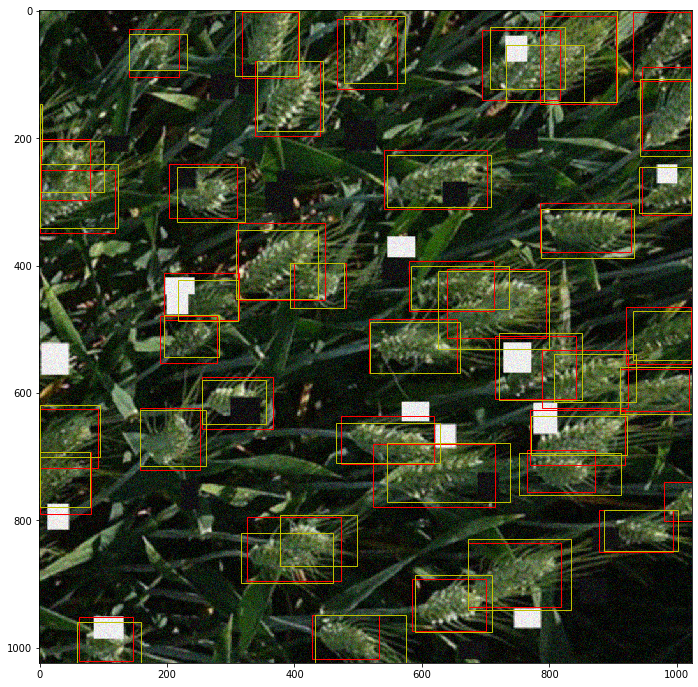

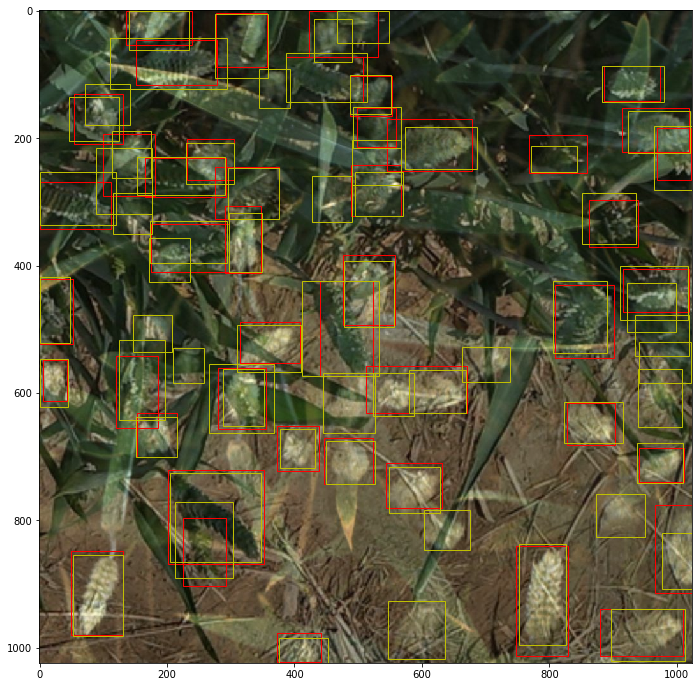

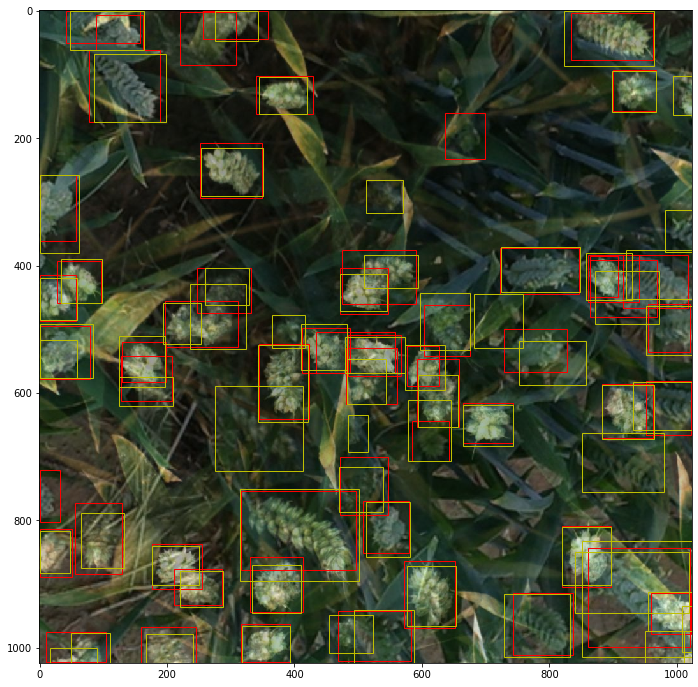

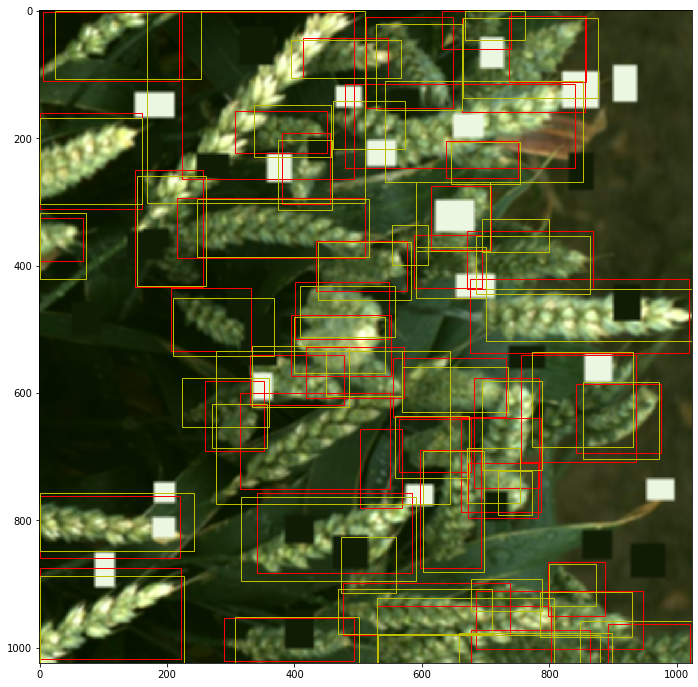

...

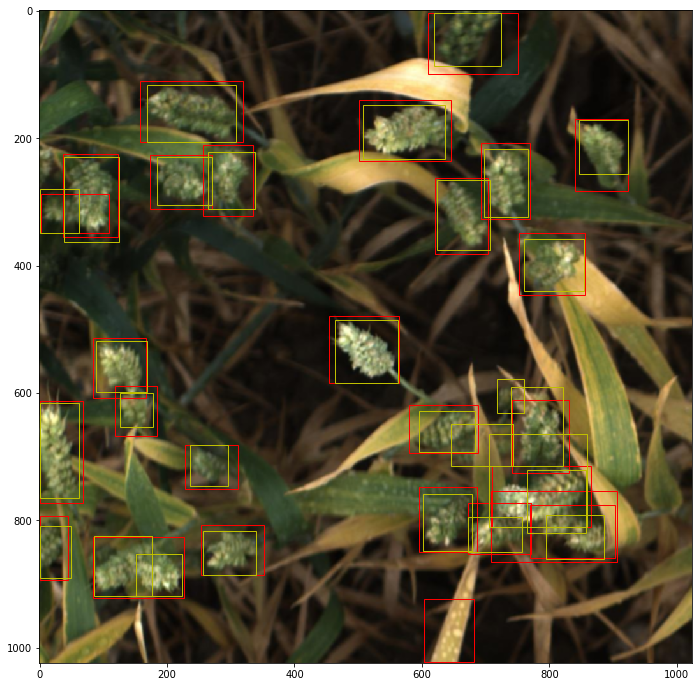

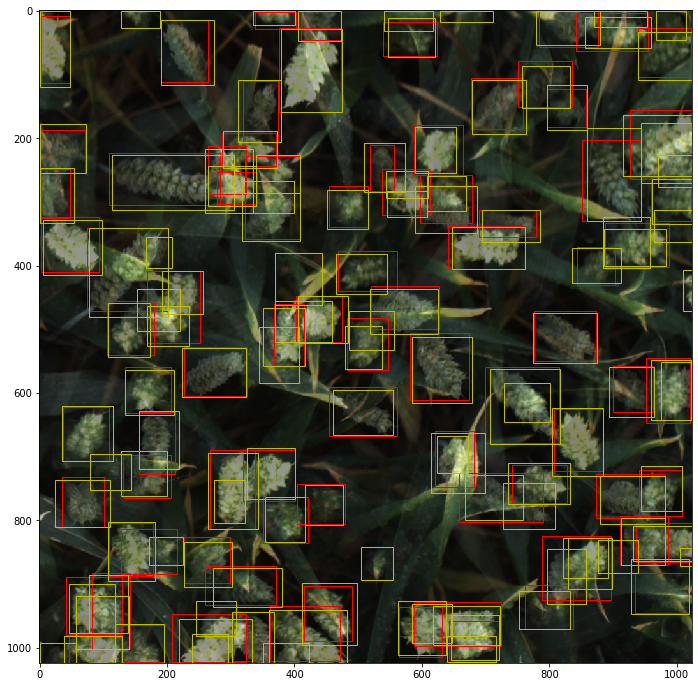

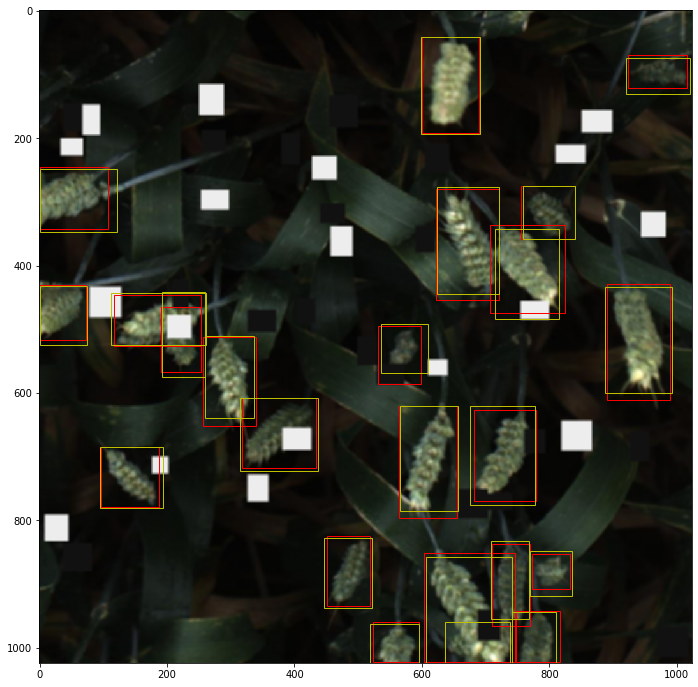

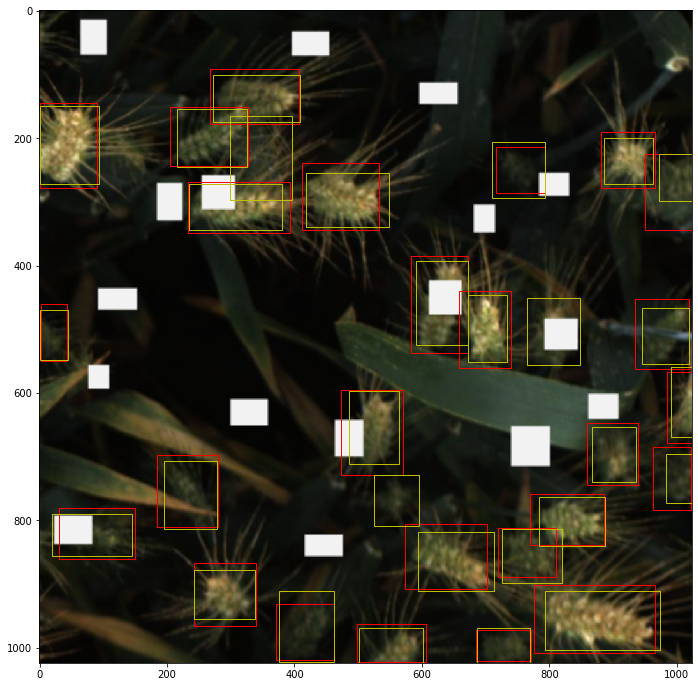

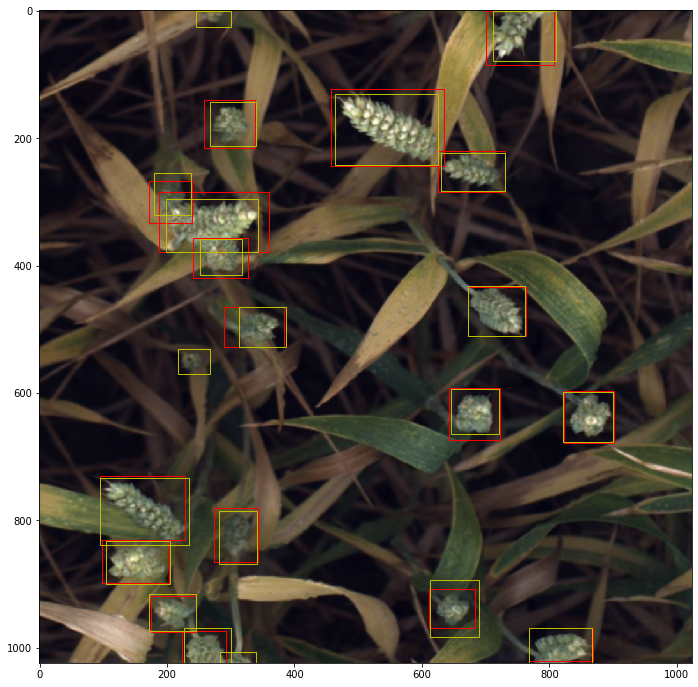

In [ ]:
last_idx=0
for imgs_id in range(len(WD_Test)//5):
    images, targets = [], []
    for i in range(last_idx, last_idx+5, 1):
        img, tgt = WD_Test[i*10]
        images.append(img)
        targets.append(tgt)
    
    r = model([torch.tensor(image).to(conf.DEVICE) for image in images])
    r = [{k: torch.tensor(v).to(torch.device('cpu')).numpy() for k, v in r_.items()} for r_ in r]
    
    
    for i in range(5):
        plot_boxes_w(images[i], r[i]['boxes'][:np.argwhere(r[i]['scores']<0.5)[0][0]], targets[i]['boxes'])
        
    last_idx+=5

In [ ]:
images, targets = [], []
for i in range(5):
    img, tgt = WD_Test[i*10]
    images.append(img)
    targets.append(tgt)

In [ ]:
r = model([torch.tensor(image).to(conf.DEVICE) for image in images])
r = [{k: torch.tensor(v).to(torch.device('cpu')).numpy() for k, v in r_.items()} for r_ in r]

In [8]:
def plot_boxes_old(img, boxes):
    img = np.array(np.moveaxis(img, 0, -1), dtype=np.float32)
    img-=np.min(img)
    img = img/np.max(img)
    plt.figure(figsize=(12, 12))
    plt.imshow(img)
    for box in boxes:
        rect = Rectangle((box[0],box[1]),box[2]-box[0],box[3]-box[1],linewidth=1,edgecolor='r',facecolor='none')
        plt.axes().add_patch(rect)
    
    plt.show()
    
def plot_boxes(img, boxes, scores):
    img = np.array(np.moveaxis(img, 0, -1)*255, dtype=np.int16)
    print(len(boxes))
    #img-=np.min(img)
    #img = img/np.max(img)
    thickness = 2
    font = cv2.FONT_HERSHEY_SIMPLEX 
    fontScale = 1
    color = (255, 0, 0)
    for (b, s) in zip(boxes, scores):
        img = cv2.rectangle(img, (b[0],b[1]), (b[2],b[3]), (255,0,0), 2)
        img = cv2.putText(img, '{:.2}'.format(s), (int(b[0])+np.random.randint(3),int(b[1])), font, fontScale, color, thickness, cv2.LINE_AA)
    plt.figure(figsize=(12, 12))
    plt.imshow(img)
    plt.show()
    
def plot_boxes_w(img, boxes, target_boxes):
    img = np.array(np.moveaxis(img, 0, -1), dtype=np.float32)
    img-=np.min(img)
    img = img/np.max(img)
    plt.figure(figsize=(12, 12))
    plt.imshow(img)
    for box in boxes:
        rect = Rectangle((box[0],box[1]),box[2]-box[0],box[3]-box[1],linewidth=1,edgecolor='r',facecolor='none')
        plt.axes().add_patch(rect)
        
    for box in target_boxes:
        rect = Rectangle((box[0],box[1]),box[2]-box[0],box[3]-box[1],linewidth=1,edgecolor='y',facecolor='none')
        plt.axes().add_patch(rect)
    
    plt.show()

# Testing Images

In [44]:
MEAN = np.array([0.31528999, 0.31725333, 0.21455572]) # in RGB - cv2 returns BGR 
STD = np.array([0.1226716 , 0.10225389, 0.06746761])
def plot_boxes(img, boxes, scores):
    img = np.array(np.moveaxis(img, 0, -1)*255, dtype=np.int16)
    print(len(boxes))
    #img-=np.min(img)
    #img = img/np.max(img)
    thickness = 2
    font = cv2.FONT_HERSHEY_SIMPLEX 
    fontScale = 1
    color = (255, 0, 0)
    for (b, s) in zip(boxes, scores):
        img = cv2.rectangle(img, (b[0],b[1]), (b[2],b[3]), (255,0,0), 2)
        img = cv2.putText(img, '{:.2}'.format(s), (int(b[0])+np.random.randint(3),int(b[1])), font, fontScale, color, thickness, cv2.LINE_AA)
    return img

In [45]:
import os
testing_images_ids = os.listdir(conf.DATA_PATH+'/test')

In [46]:
testing_images = []
ori_images = []
import cv2
for testing_images_id in testing_images_ids:
    img_path =  os.path.join(conf.DATA_PATH, 'test', testing_images_id)
    img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)/255
    
    or_imgs = img.copy()
    or_imgs = np.array(np.moveaxis(or_imgs, -1, 0), dtype=np.float32)
    ori_images.append(or_imgs)
    
    #img = (img-MEAN)/STD
    img = np.array(np.moveaxis(img, -1, 0), dtype=np.float32)
    testing_images.append(img)

In [47]:
results = model([torch.tensor(img).to(conf.DEVICE) for img in testing_images])
results = [{k: v.to(torch.device('cpu')).detach().numpy() for k, v in target.items()} for target in results]
boxes = [result['boxes']/1024 for result in results]
scores = [result['scores'] for result in results]
labels = [result['labels'] for result in results]

54
42


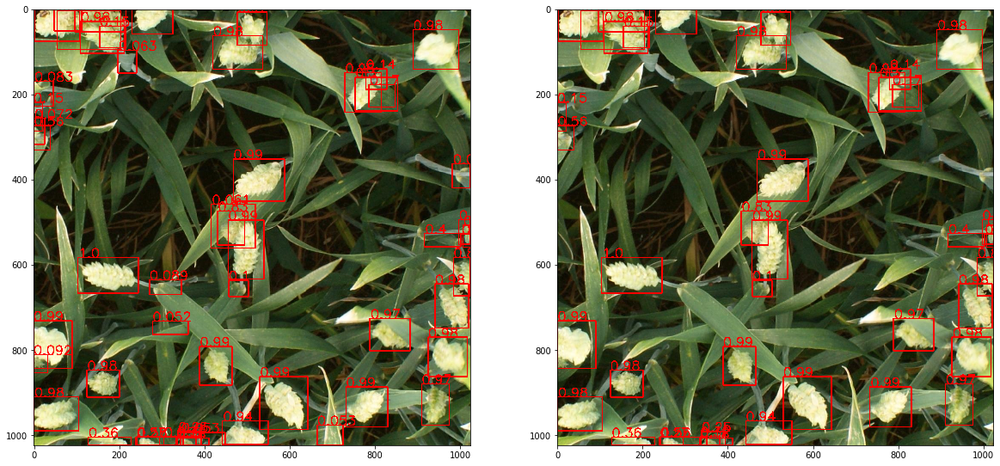

47
40


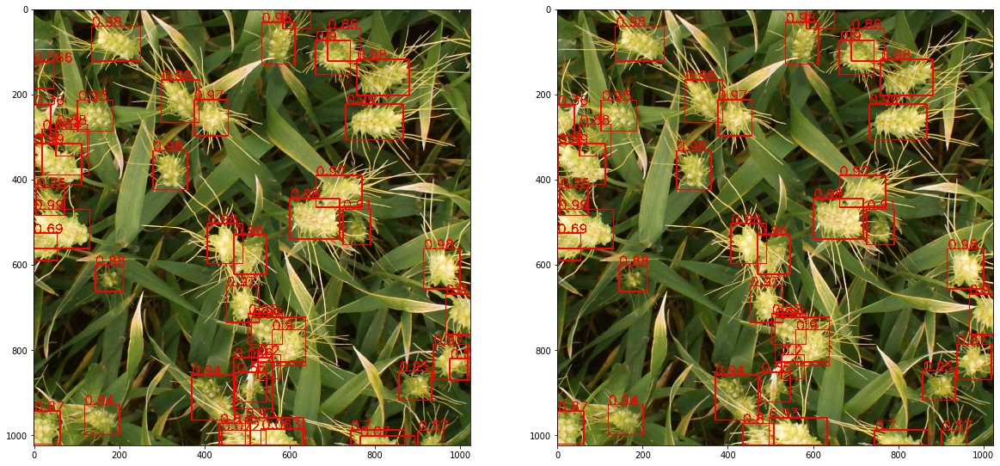

64
45


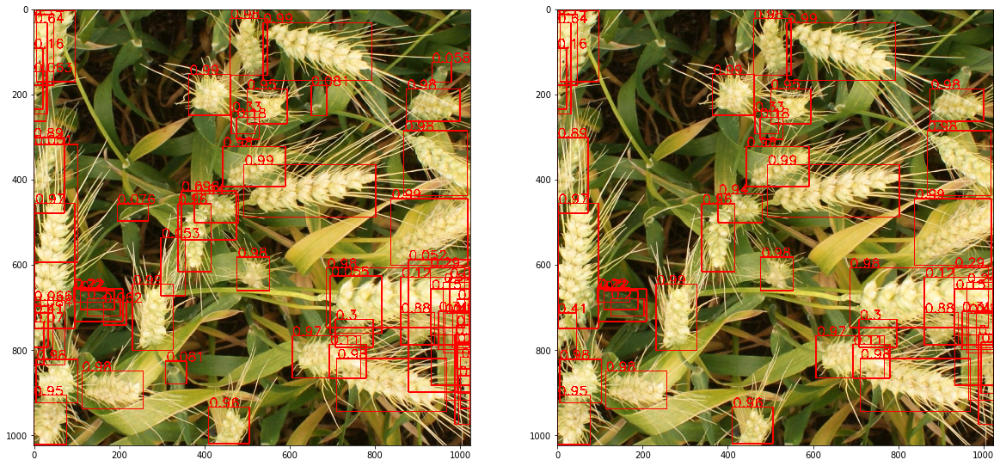

100
85


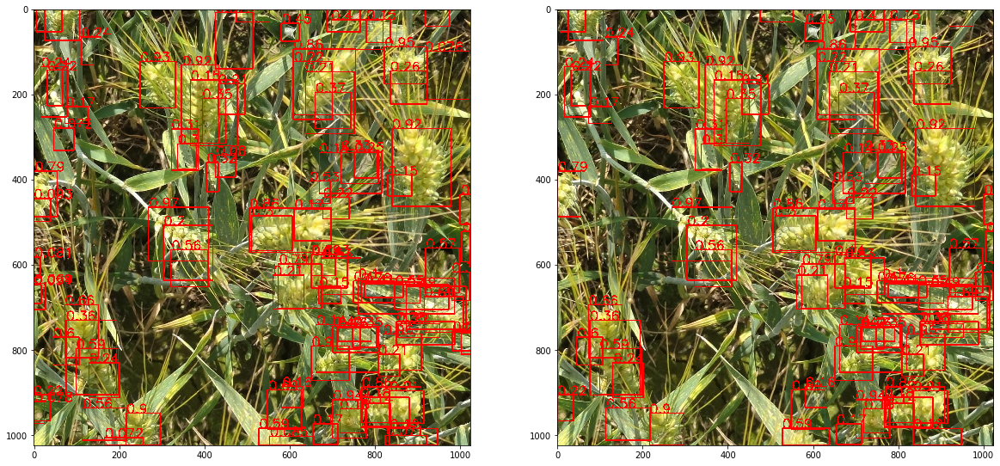

52
41


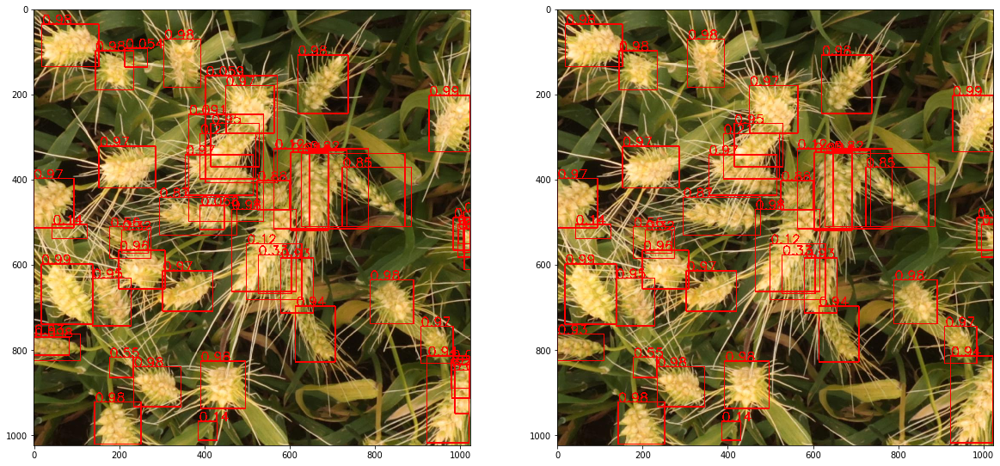

55
38


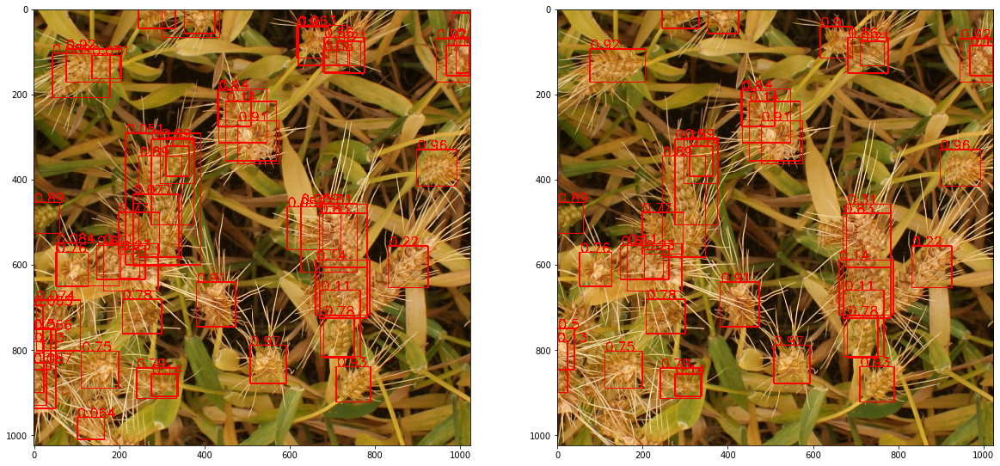

96
73


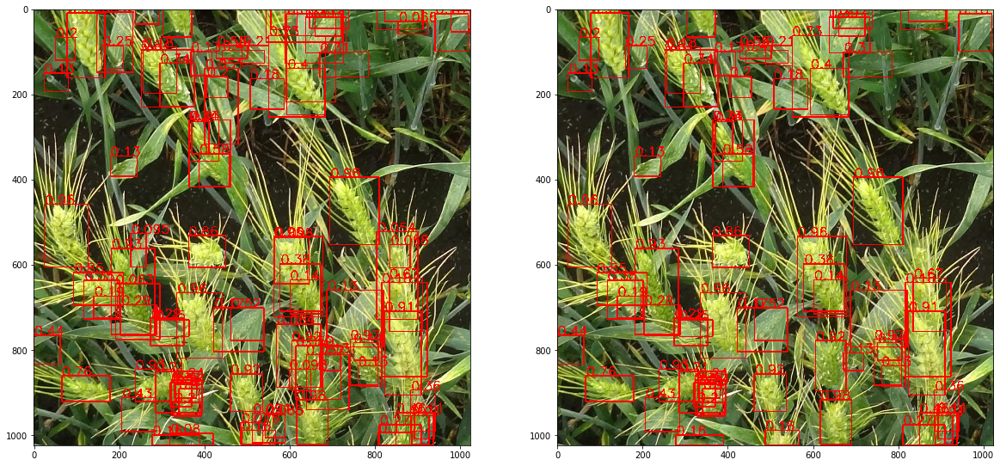

41
31


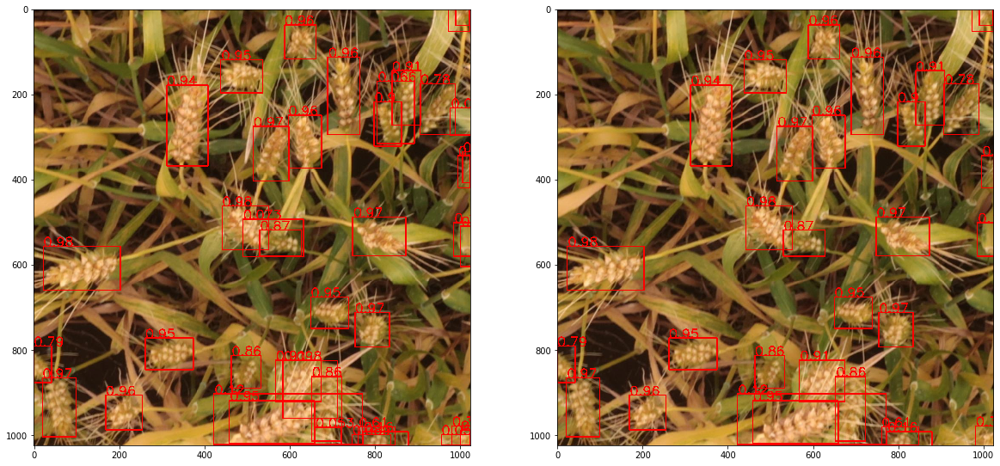

42
34


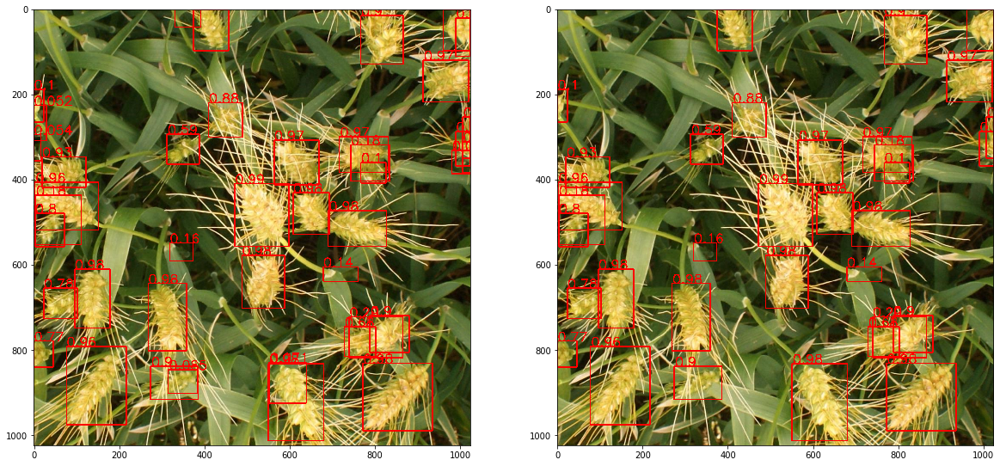

43
40


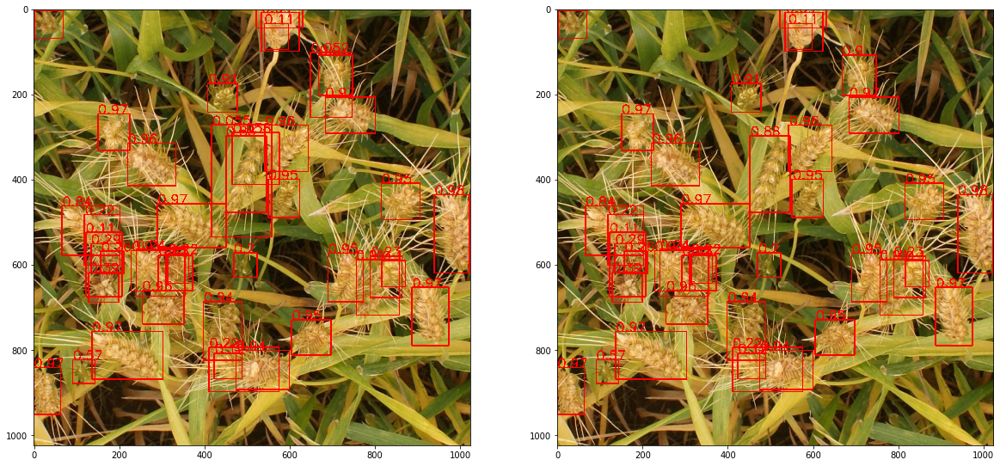

In [69]:
thresh=0

WBFS = [weighted_boxes_fusion([box], 
                             [score], 
                             [label], 
                             weights=[1], 
                             iou_thr=0.55, 
                             skip_box_thr=0.1) 
       for (box, score, label) 
       in zip(boxes, scores, labels)]


for i in range(10):
    fig = plt.figure(figsize=(20, 10))
    try:
        b__ = results[i]['boxes'][:np.argwhere(results[i]['scores']<thresh)[0][0]]
    except:
        b__ = results[i]['boxes']
        
    try:
        s__ = results[i]['scores'][:np.argwhere(results[i]['scores']<thresh)[0][0]]
    except:
        s__ = results[i]['scores']
    i__ = plot_boxes(ori_images[i], b__, s__)
    fig.add_subplot(1, 2, 1)
    plt.imshow(i__)
    
    
    try:
        b__ = np.array(WBFS[i][0]*1024, dtype=np.float32)[:np.argwhere(WBFS[i][1]<thresh)[0][0]]
    except:
        b__ = np.array(WBFS[i][0]*1024, dtype=np.float32)
    try:
        s__ = np.array(WBFS[i][1], dtype=np.float32)[:np.argwhere(WBFS[i][1]<thresh)[0][0]]
    except:
        s__ = np.array(WBFS[i][1], dtype=np.float32)
    i__ = plot_boxes(ori_images[i], b__, s__)
    fig.add_subplot(1, 2, 2)
    plt.imshow(i__)
    
    plt.show()

In [70]:
from global_utils.weighted_boxes_fusion.ensemble_boxes import *

In [13]:
boxes_list = [[
    [0.00, 0.51, 0.81, 0.91],
    [0.10, 0.31, 0.71, 0.61],
    [0.01, 0.32, 0.83, 0.93],
    [0.02, 0.53, 0.11, 0.94],
    [0.03, 0.24, 0.12, 0.35],
    [0.04, 0.56, 0.84, 0.92],
    [0.12, 0.33, 0.72, 0.64],
    [0.38, 0.66, 0.79, 0.95],
    [0.08, 0.49, 0.21, 0.89]
],[
    [0.04, 0.56, 0.84, 0.92],
    [0.12, 0.33, 0.72, 0.64],
    [0.38, 0.66, 0.79, 0.95],
    [0.08, 0.49, 0.21, 0.89],
]]
scores_list = [[0.9, 0.8, 0.2, 0.4, 0.7, 0.9, 0.9, 0.7, 0.3], [0.9, 0.9, 0.7, 0.3]]
labels_list = [[0, 1, 0, 1, 1, 1, 1, 1, 0], [1, 1, 1, 0]]
weights = [1, 1]

iou_thr = 0.5
skip_box_thr = 0.0001
sigma = 0.1

boxes, scores, labels = nms(boxes_list, scores_list, labels_list, weights=weights, iou_thr=iou_thr)

boxes, scores, labels = soft_nms(boxes_list, scores_list, labels_list, weights=weights, iou_thr=iou_thr, sigma=sigma, thresh=skip_box_thr)
boxes, scores, labels = non_maximum_weighted(boxes_list, scores_list, labels_list, weights=weights, iou_thr=iou_thr, skip_box_thr=skip_box_thr)
boxes, scores, labels = weighted_boxes_fusion(boxes_list, scores_list, labels_list, weights=weights, iou_thr=iou_thr, skip_box_thr=skip_box_thr)

print(boxes, scores, labels)

[[0.04       0.56       0.83999997 0.92000002]
 [0.11384616 0.32384616 0.71692312 0.63076925]
 [0.38000003 0.66000003 0.78999996 0.95000005]
 [0.00181818 0.47545454 0.8136363  0.91363633]
 [0.03       0.24       0.12       0.35      ]
 [0.08       0.48999998 0.20999999 0.88999993]
 [0.02       0.53       0.11       0.94      ]] [0.1125     0.10833333 0.0875     0.06875    0.04375    0.0375
 0.025     ] [1. 1. 1. 0. 1. 0. 1.]
